In [42]:
%load_ext autoreload
%autoreload 2

import sys
sys.path.insert(0, '../../')

In [43]:
import seaborn as sns
import numpy as np
import pandas as pd


import transformer_anatomy
from transformer_anatomy.utils import get_results

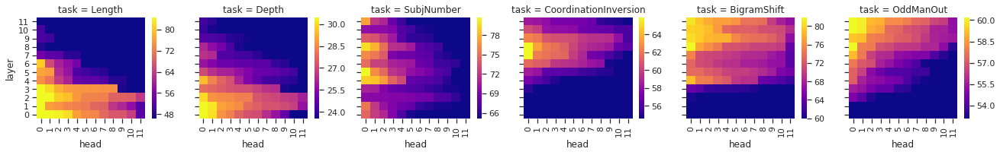

In [44]:
plt_cmap = 'plasma'# 'viridis'
subtask_order = ['Length', 'Depth', 'SubjNumber', 'CoordinationInversion', 'BigramShift', 'OddManOut']
dir_path = '../../results/linear_head_wise_results'
img_save_path = '../../imgs'

def draw_heatmap(*args, **kwargs):
    data = kwargs.pop('data')
    d = data.pivot(index=args[1], columns=args[0], values=args[2])
    data = d.values
    data.sort(axis=1)
    vmin = np.min(data)
    vmax = np.max(data)
    vmin_ = vmin + 0.3*(vmax-vmin)
    vmax_ = vmax - 0.05*(vmax-vmin) 
    
    d.iloc[:,:] = np.flip(data, 1)
    sns.heatmap(d[::-1], **kwargs, vmin=vmin_, vmax=vmax_)

df = get_results(dir_path=dir_path, model_name='bert-base-uncased', part='head')

fg = sns.FacetGrid(df, col='task', col_wrap=10, col_order=subtask_order)
fg.map_dataframe(draw_heatmap, 'head', 'layer', 'acc', cbar=True, square = False, cmap=plt_cmap)
# fg.savefig(join(img_save_path, 'fig3_bertbase.svg'), format='svg', bbox_inches='tight')


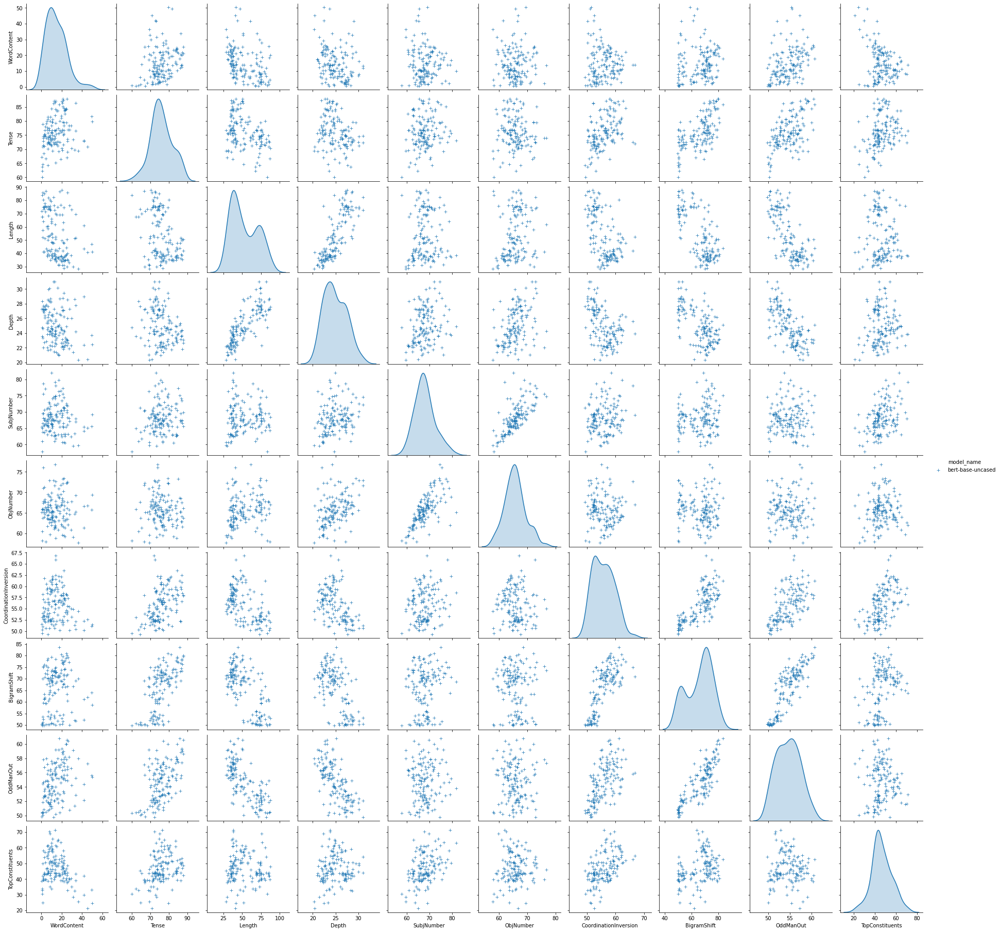

In [21]:
pair_df = get_results(dir_path=dir_path, model_name='bert-base-uncased', part='head')
pair_df = pair_df.loc[pair_df['model_name'] != 'transfo-xl-wt103']
pair_df = pair_df.pivot_table(index=['model_name', 'layer', 'head'], columns='task', values='acc')
pair_df = pair_df.reset_index()
sns.pairplot(pair_df, hue='model_name', markers="+", vars=['WordContent', 'Tense', 'Length',  'Depth', 'SubjNumber', 'ObjNumber', 'CoordinationInversion', 'BigramShift', 'OddManOut', 'TopConstituents'])

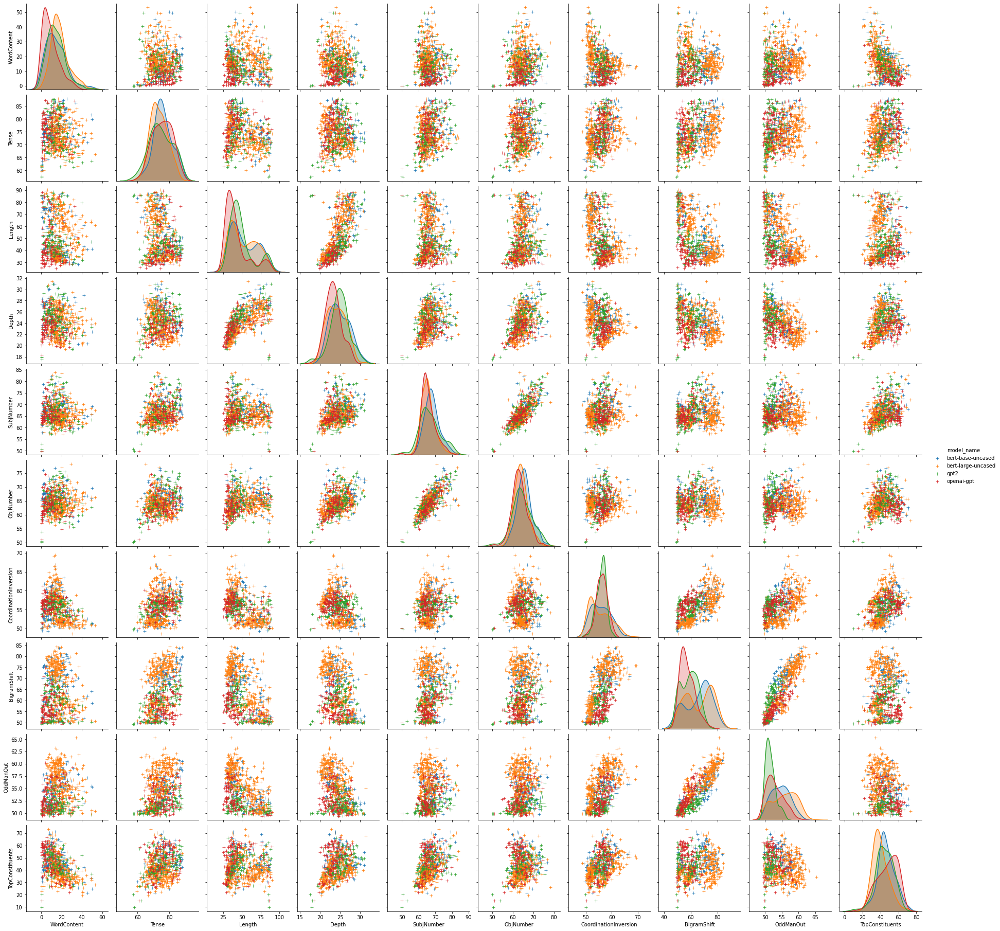

In [23]:
pair_df = get_results(dir_path=dir_path, part='head')
pair_df = pair_df.loc[pair_df['model_name'] != 'transfo-xl-wt103']
pair_df = pair_df.pivot_table(index=['model_name', 'layer', 'head'], columns='task', values='acc')
pair_df = pair_df.reset_index()
sns.pairplot(pair_df, hue='model_name', markers="+", vars=['WordContent', 'Tense', 'Length',  'Depth', 'SubjNumber', 'ObjNumber', 'CoordinationInversion', 'BigramShift', 'OddManOut', 'TopConstituents'])

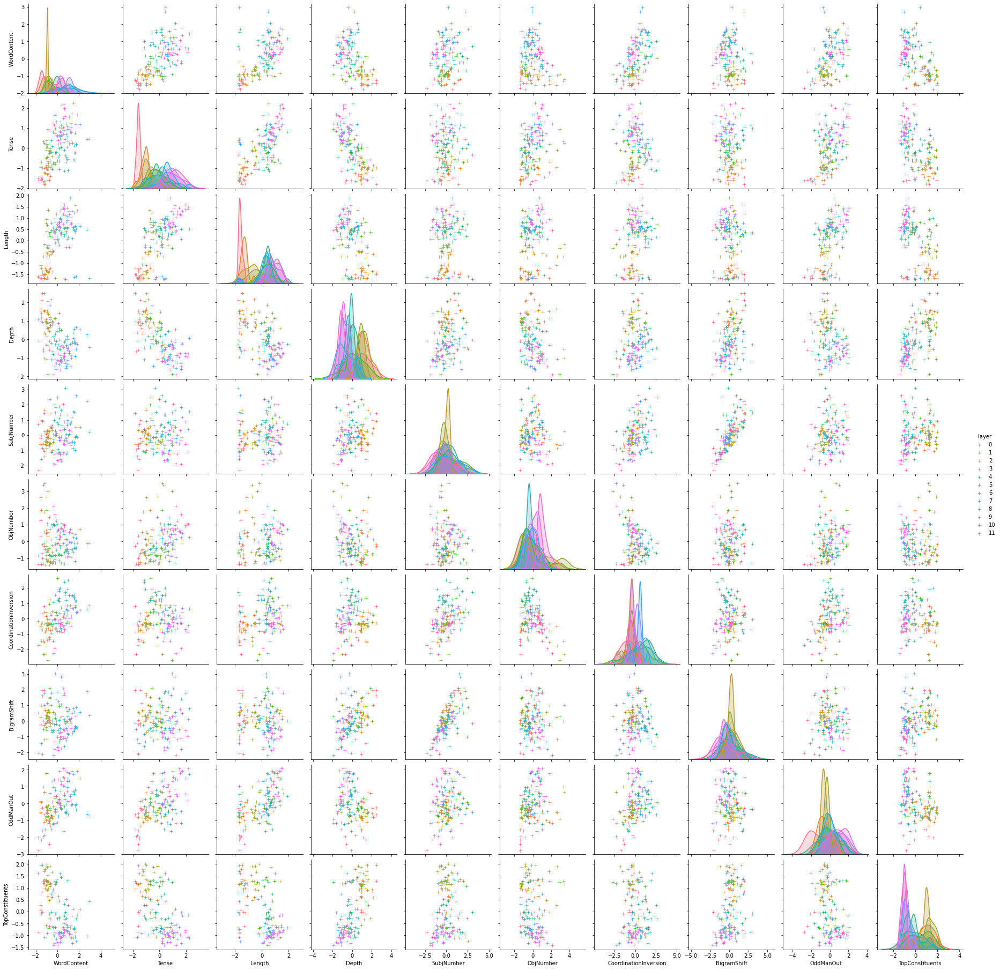

In [70]:
pair_df = get_results(dir_path=dir_path, part='head', model_name='bert-base-uncased')
pair_df = pair_df.loc[pair_df['model_name'] != 'transfo-xl-wt103']

# normalization
std_df = pair_df.groupby(['model_name', 'task']).std()['acc']
mean_df = pair_df.groupby(['model_name', 'task']).mean()['acc']
acc_df = pair_df.set_index(['model_name', 'task'])['acc']
normed_df = pd.DataFrame({'normed':(acc_df - mean_df) / std_df}).reset_index()

# merging 
pair_df = pair_df.reset_index()
pair_df['normed'] = normed_df['normed']


pair_df = pair_df.pivot_table(index=['model_name', 'layer', 'head'], columns='task', values='normed')
pair_df = pair_df.reset_index()
sns.pairplot(pair_df, hue='layer', markers="+", vars=['WordContent', 'Tense', 'Length',  'Depth', 'SubjNumber', 'ObjNumber', 'CoordinationInversion', 'BigramShift', 'OddManOut', 'TopConstituents'])


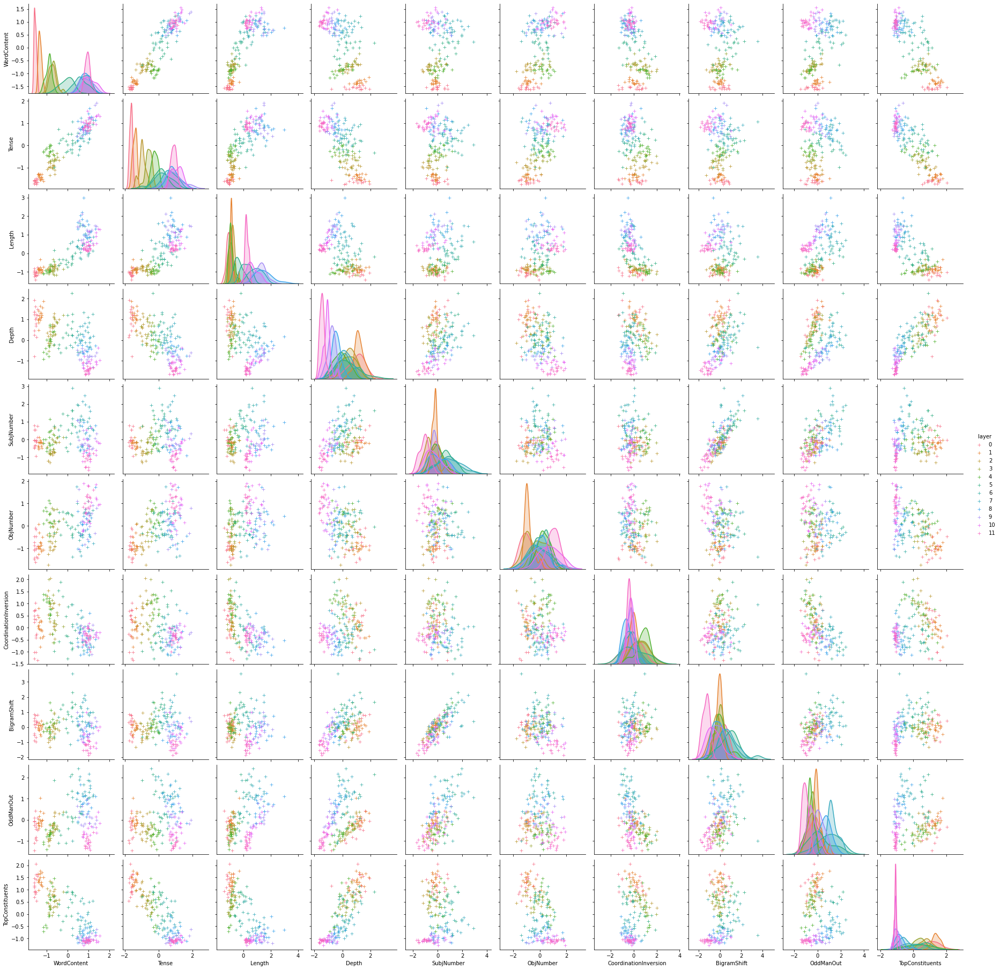

In [76]:
pair_df = get_results(dir_path=dir_path, part='head', model_name='bert-large-uncased')
pair_df = pair_df.loc[pair_df['model_name'] != 'transfo-xl-wt103']

# normalization
std_df = pair_df.groupby(['model_name', 'task']).std()['acc']
mean_df = pair_df.groupby(['model_name', 'task']).mean()['acc']
acc_df = pair_df.set_index(['model_name', 'task'])['acc']
normed_df = pd.DataFrame({'normed':(acc_df - mean_df) / std_df}).reset_index()

# merging 
pair_df = pair_df.reset_index()
pair_df['normed'] = normed_df['normed']

pair_df['layer'] = pair_df['layer'].apply(lambda x: int(x/2))

pair_df = pair_df.pivot_table(index=['model_name', 'layer', 'head'], columns='task', values='normed')
pair_df = pair_df.reset_index()
sns.pairplot(pair_df, hue='layer', markers="+", vars=['WordContent', 'Tense', 'Length',  'Depth', 'SubjNumber', 'ObjNumber', 'CoordinationInversion', 'BigramShift', 'OddManOut', 'TopConstituents'])


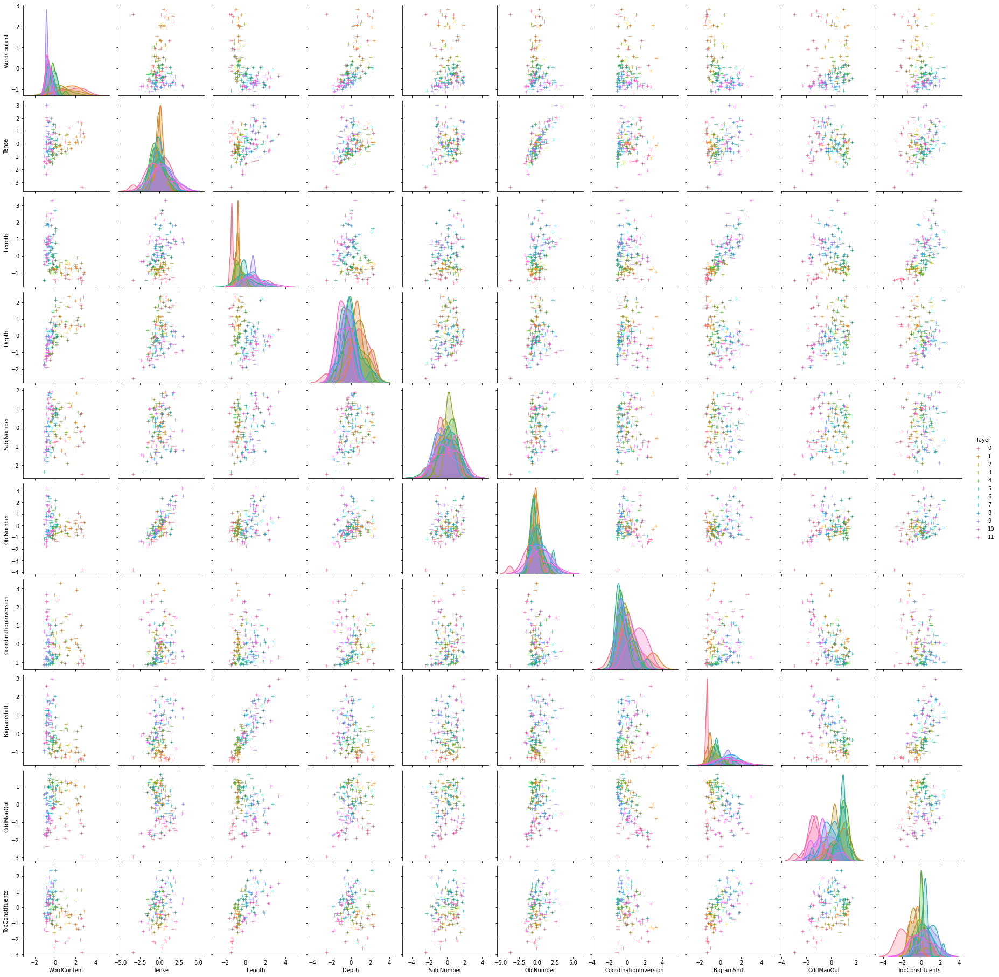

In [77]:
pair_df = get_results(dir_path=dir_path, part='head', model_name='openai-gpt')
pair_df = pair_df.loc[pair_df['model_name'] != 'transfo-xl-wt103']

# normalization
std_df = pair_df.groupby(['model_name', 'task']).std()['acc']
mean_df = pair_df.groupby(['model_name', 'task']).mean()['acc']
acc_df = pair_df.set_index(['model_name', 'task'])['acc']
normed_df = pd.DataFrame({'normed':(acc_df - mean_df) / std_df}).reset_index()

# merging 
pair_df = pair_df.reset_index()
pair_df['normed'] = normed_df['normed']


pair_df = pair_df.pivot_table(index=['model_name', 'layer', 'head'], columns='task', values='normed')
pair_df = pair_df.reset_index()
sns.pairplot(pair_df, hue='layer', markers="+", vars=['WordContent', 'Tense', 'Length',  'Depth', 'SubjNumber', 'ObjNumber', 'CoordinationInversion', 'BigramShift', 'OddManOut', 'TopConstituents'])


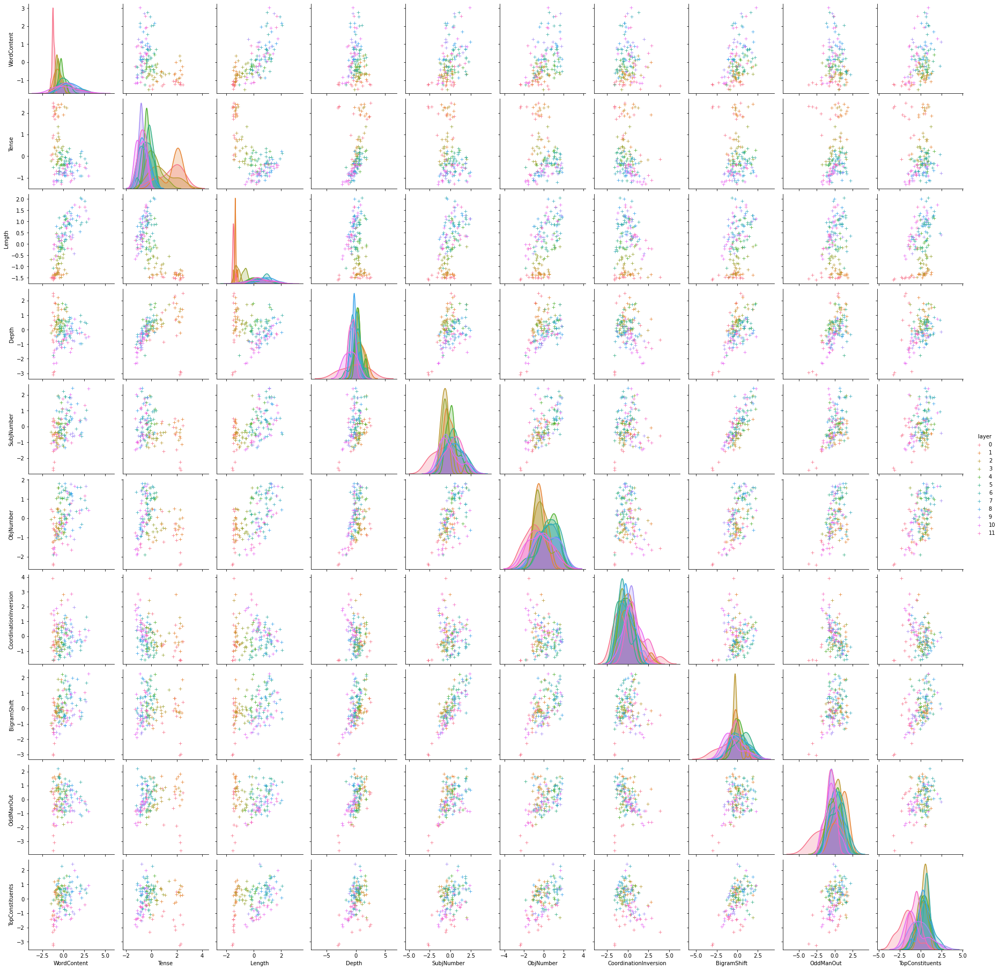

In [78]:
pair_df = get_results(dir_path=dir_path, part='head', model_name='gpt2')
pair_df = pair_df.loc[pair_df['model_name'] != 'transfo-xl-wt103']

# normalization
std_df = pair_df.groupby(['model_name', 'task']).std()['acc']
mean_df = pair_df.groupby(['model_name', 'task']).mean()['acc']
acc_df = pair_df.set_index(['model_name', 'task'])['acc']
normed_df = pd.DataFrame({'normed':(acc_df - mean_df) / std_df}).reset_index()

# merging 
pair_df = pair_df.reset_index()
pair_df['normed'] = normed_df['normed']


pair_df = pair_df.pivot_table(index=['model_name', 'layer', 'head'], columns='task', values='normed')
pair_df = pair_df.reset_index()
sns.pairplot(pair_df, hue='layer', markers="+", vars=['WordContent', 'Tense', 'Length',  'Depth', 'SubjNumber', 'ObjNumber', 'CoordinationInversion', 'BigramShift', 'OddManOut', 'TopConstituents'])


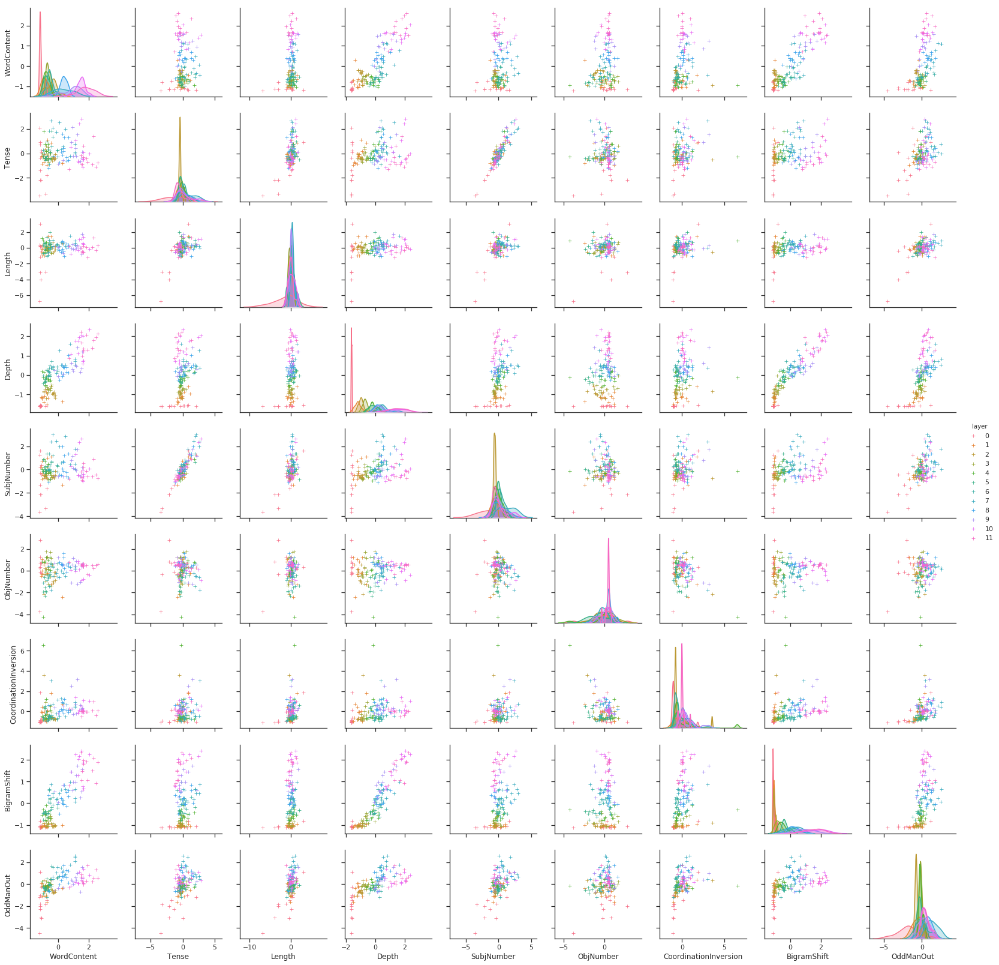

In [50]:
pair_df = get_results(dir_path=dir_path, part='head', model_name='electra-base-discriminator')
pair_df = pair_df.loc[pair_df['model_name'] != 'transfo-xl-wt103']

# normalization
std_df = pair_df.groupby(['model_name', 'task']).std()['acc']
mean_df = pair_df.groupby(['model_name', 'task']).mean()['acc']
acc_df = pair_df.set_index(['model_name', 'task'])['acc']
normed_df = pd.DataFrame({'normed':(acc_df - mean_df) / std_df}).reset_index()

# merging 
pair_df = pair_df.reset_index()
pair_df['normed'] = normed_df['normed']

# pair_df['layer'] = pair_df['layer'].apply(lambda x: int(x/2))

pair_df = pair_df.pivot_table(index=['model_name', 'layer', 'head'], columns='task', values='normed')
pair_df = pair_df.reset_index()
sns.pairplot(pair_df, hue='layer', markers="+", vars=['WordContent', 'Tense', 'Length',  'Depth', 'SubjNumber', 'ObjNumber', 'CoordinationInversion', 'BigramShift', 'OddManOut']) #, 'TopConstituents'


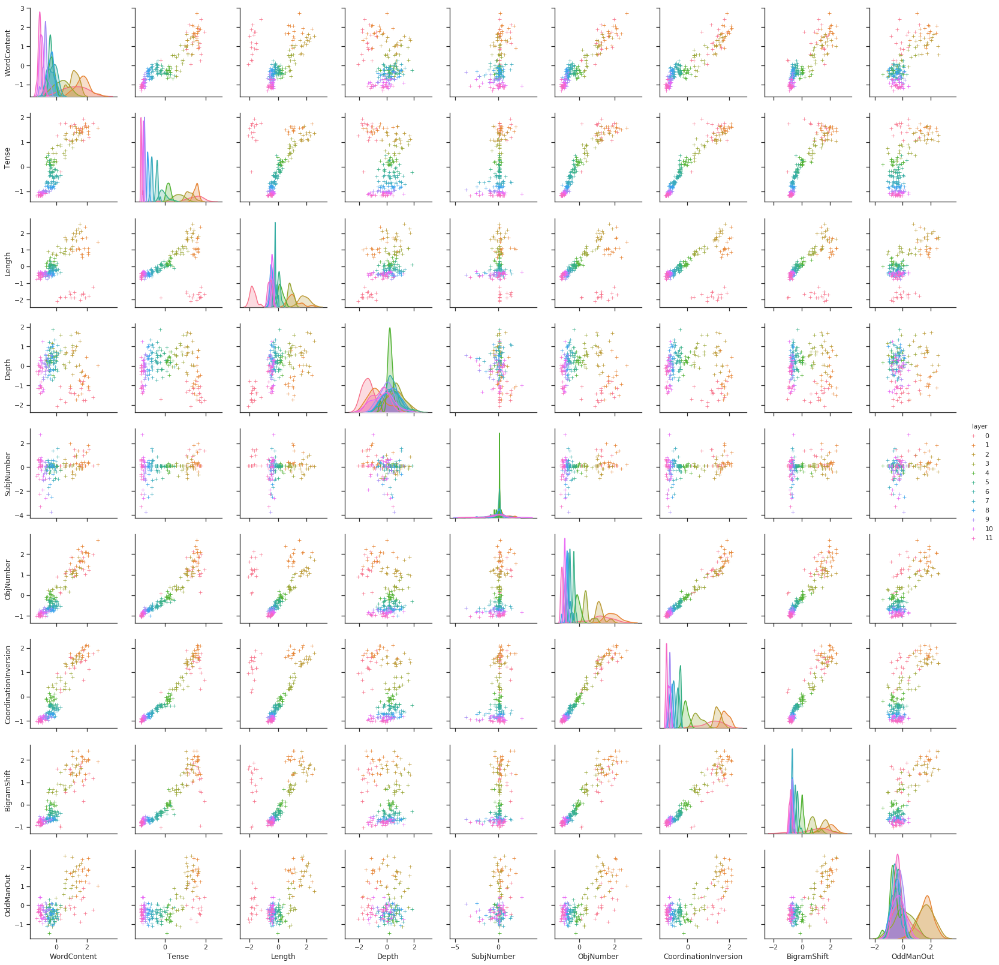

In [47]:
pair_df = get_results(dir_path=dir_path, part='head', model_name='electra-large-discriminator')
pair_df = pair_df.loc[pair_df['model_name'] != 'transfo-xl-wt103']

# normalization
std_df = pair_df.groupby(['model_name', 'task']).std()['acc']
mean_df = pair_df.groupby(['model_name', 'task']).mean()['acc']
acc_df = pair_df.set_index(['model_name', 'task'])['acc']
normed_df = pd.DataFrame({'normed':(acc_df - mean_df) / std_df}).reset_index()

# merging 
pair_df = pair_df.reset_index()
pair_df['normed'] = normed_df['normed']

pair_df['layer'] = pair_df['layer'].apply(lambda x: int(x/2))

pair_df = pair_df.pivot_table(index=['model_name', 'layer', 'head'], columns='task', values='normed')
pair_df = pair_df.reset_index()
sns.pairplot(pair_df, hue='layer', markers="+", vars=['WordContent', 'Tense', 'Length',  'Depth', 'SubjNumber', 'ObjNumber', 'CoordinationInversion', 'BigramShift', 'OddManOut']) #, 'TopConstituents'
